In [1]:
import numpy as np
import pandas as pd
import geopandas as gpd
import json

In [2]:
%load_ext autoreload
%autoreload 2

import sys
sys.path.append(f'E:\gitlab\custom-script\script')
from ursar import maps,statistic,optimization

%reload_ext autoreload

# shape plot

In [3]:
shape = r'E:\gitlab\machine-learning\dataset\map dataset\nyc\geo_export_82ac2965-ee41-4025-a13c-a89394b58021.shp'

In [4]:
df = pd.read_csv(r'E:\gitlab\machine-learning\dataset\map dataset\nyc\coded_locs.csv',names=['name','latitude','longitude'])

In [5]:
df['ran'] = np.random.randint(1, 17, df.shape[0])

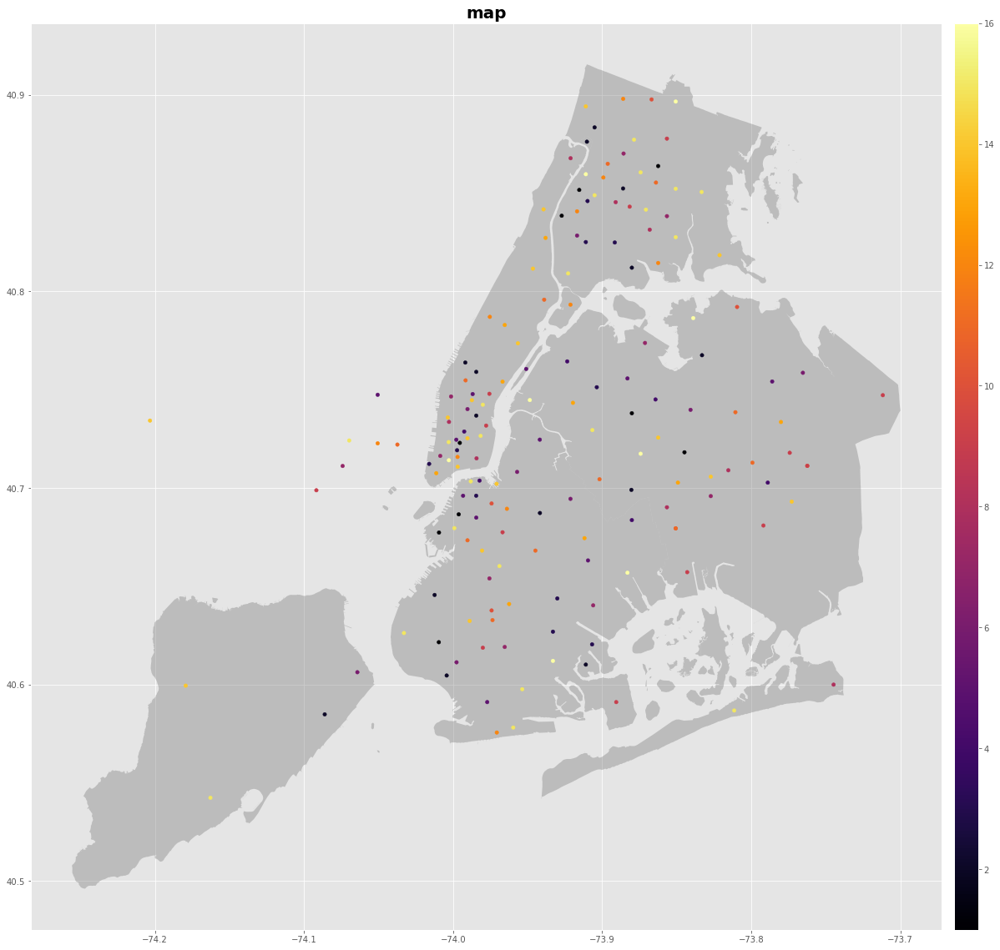

In [6]:
maps.map_shape(df,shape,'ran',col_loc=['longitude','latitude'],title='map')

# simple map

In [7]:
df = pd.read_csv(r'E:\gitlab\machine-learning\dataset\map dataset\starbucksInLACounty.csv')

In [8]:
with open(r'E:\gitlab\machine-learning\dataset\map dataset\laMap.geojson') as f:
    laArea = json.load(f)

In [10]:
maps.map_marker_fol_plot(df,laArea,col_list=['latitude','longitude'],center_coor=[34.0522,-118.2437])

In [11]:
maps.map_marker_fol_plot(df,laArea,col_list=['latitude','longitude'],marker='point',center_coor=[34.0522,-118.2437])

## Choropleth using zip code

In [12]:
shape = r'E:\gitlab\machine-learning\dataset\map dataset\laZips.geojson'

In [13]:
numStoresSeries = df.groupby('zip').count().id
numStoresByZip = pd.DataFrame()
numStoresByZip['zipcode'] = [str(i) for i in numStoresSeries.index]
numStoresByZip['numStores'] = numStoresSeries.values

In [14]:
numStoresByZip

,zipcode,numStores
0,90001,2
1,90004,1
2,90007,4
3,90010,3
4,90012,6
...,...,...
236,93535,1
237,93536,4
238,93550,2
239,93551,5


In [15]:
maps.map_marker_fol_plot(numStoresByZip,shape=shape,col_list=['zipcode', 'numStores'],zoom=9,marker='choropleth',center_coor=[34.0522,-118.2437])

## heatmap plot

### Dummy data

In [16]:
dummy = maps.dummy_data(10,15,100,10)

In [17]:
dummy = pd.DataFrame(dummy,columns=['latitude','longitude',"value"])

In [18]:
dummy

,latitude,longitude,value
0,15.241630,98.925549,9.134212
1,13.804929,100.440078,8.571455
2,14.449233,100.718057,11.175285
3,14.460243,98.774938,9.914309
4,14.428910,100.259446,9.196567
5,16.300625,99.595641,9.725140
6,15.878896,100.793272,9.719061
7,14.777781,101.081181,9.038950
8,15.390799,99.649976,9.960269
9,14.995484,99.704432,11.244083


### heatmap plot

In [19]:
maps.map_marker_fol_plot(dummy,shape=None,col_list=['latitude','longitude'],marker='heatmap',center_coor=[14.364110,99.495856],zoom=6)

# Map plot

In [28]:
df = pd.read_csv('E:/gitlab/machine-learning/dataset/geo_data.csv')
# url = 'https://raw.githubusercontent.com/python-visualization/folium/master/examples/data'
# country_shapes = f'{url}/world-countries.json'
global_polygons = gpd.read_file('global_polygons.geojson')
global_polygons.to_file('global_polygons.geojson', driver = 'GeoJSON')
medals_map = pd.merge(global_polygons, df, left_on='name',right_on='region')

In [29]:
maps.map_plot(medals_map,'region',"Total",["name","Total","Gold","Silver","Bronze"]
                        ,title=None,poly='Polygon')

# map plot marker

In [30]:
df = pd.read_csv("E:/gitlab/machine-learning/dataset/district wise population and centroids.csv")

In [31]:
maps.map_marker_plot(df[df.State == "Gujarat"],
                     ["District", "Longitude", "Latitude"],23,73)

Map(center=[23, 73], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

In [32]:
maps.map_marker_plot(df[df.State == "Gujarat"],
                     ["District", "Longitude", "Latitude"],23,73,cluster=True)

Map(center=[23, 73], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

In [33]:
maps.map_marker_plot(df[df.State == "Gujarat"],
                     ["District", "Longitude", "Latitude"],23,73,cluster=True,
                    icon_path='https://image.flaticon.com/icons/png/128/2968/2968342.png')

Map(center=[23, 73], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

In [34]:
maps.map_marker_plot(df[df.State == "Gujarat"],
                     ["District", "Longitude", "Latitude"],23,73,cluster=True,
                    icon='podcast')

Map(center=[23, 73], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

In [35]:
maps.map_marker_plot(df[df.State == "Gujarat"],
                     ["District", "Population in 2011","Longitude", "Latitude"],23,73,
                     popup=True,cluster = True)

Map(center=[23, 73], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

In [36]:
maps.map_marker_plot(df[df.State == "Gujarat"],
                     ["District", "Population in 2011","Longitude", "Latitude"],23,73,
                     popup=True)

Map(center=[23, 73], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

In [37]:
df[df.State == "Gujarat"]

,State,District,Latitude,Longitude,Population in 2001,Population in 2011
92,Gujarat,Amreli,21.048326,71.434576,1393918,1514190
93,Gujarat,Anand,22.282718,72.577821,1856872,2092745
94,Gujarat,Banas Kantha,24.258539,71.932053,2504244,3120506
95,Gujarat,Bharuch,21.757873,72.673263,1370656,1551019
96,Gujarat,Bhavnagar,21.702194,72.162726,2469630,2880365
97,Gujarat,Gandhinagar,23.193680,72.672217,1237168,1391753
98,Gujarat,Jamnagar,22.410600,69.620620,1904278,2160119
99,Gujarat,Junagadh,20.929523,70.547339,2448173,2743082
100,Gujarat,Kachchh,23.480572,68.821923,1583225,2092371
101,Gujarat,Kheda,22.887653,73.018804,2037894,2299885


In [38]:
df1 = df[df.State == "Gujarat"][["Latitude", "Longitude"]][:3].values.tolist()
df2 = df[df.State == "Gujarat"][["Latitude", "Longitude"]][8:12].values.tolist()

In [39]:
maps.map_marker_plot(df[df.State == "Gujarat"],
                     ["District", "Population in 2011","Longitude", "Latitude"],23,73,
                     popup=True,poly=df1)

Map(center=[23, 73], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

In [40]:
maps.map_marker_plot(df[df.State == "Gujarat"],
                     ["District", "Population in 2011","Longitude", "Latitude"],23,73,
                     popup=True,poly=df1)

Map(center=[23, 73], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

In [41]:
maps.map_marker_plot(df[df.State == "Gujarat"],
                     ["District", "Population in 2011","Longitude", "Latitude"],23,73,
                     popup=True,poly=[df1,df2])

Map(center=[23, 73], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

In [42]:
df1 = df[df.State == "Gujarat"][["Latitude", "Longitude"]][19:21].values.tolist()

In [43]:
df1

[[22.26133739279589, 73.49433010291594],
 [20.44238231644259, 72.91485847983449]]

In [44]:
maps.map_marker_plot(df[df.State == "Gujarat"],
                     ["District", "Population in 2011","Longitude", "Latitude"],23,73,
                     popup=True,rectangle=df1)

Map(center=[23, 73], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

In [45]:
df['Population in 2011'] = df['Population in 2011']//100

In [46]:
maps.map_marker_plot(df[df.State == "Gujarat"],
                     ["District", "Population in 2011","Longitude", "Latitude"],23,73,
                     mark_size=True)

Map(center=[23, 73], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

In [47]:
maps.map_marker_plot(df[df.State == "Gujarat"],
                     ["District", "Population in 2011","Longitude", "Latitude"],23,73,
                     mark_size=True,cluster = True)

Map(center=[23, 73], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_out_tex…

# Indonesia map

In [ ]:
df = pd.read_excel(f'E:\gitlab\machine-learning\dataset\map dataset\indonesia map\Angka Partisipasi Sekolah.xlsx')
df.head()

In [ ]:
maps.indonesia_map(df,'Province','19-24',values=True,ranges=[0,4000],
                   title='School Participations Rate for Age 19-24',
                   footnote='Source: Badan Pusat Statistik Indonesia')

# Kepler map

In [58]:
df = pd.read_csv(f'E:\gitlab\machine-learning\dataset\map dataset\Worldwide-Earthquake-database.csv')

In [59]:
df

,I_D,FLAG_TSUNAMI,YEAR,MONTH,DAY,HOUR,MINUTE,SECOND,FOCAL_DEPTH,EQ_PRIMARY,...,TOTAL_MISSING,TOTAL_MISSING_DESCRIPTION,TOTAL_INJURIES,TOTAL_INJURIES_DESCRIPTION,TOTAL_DAMAGE_MILLIONS_DOLLARS,TOTAL_DAMAGE_DESCRIPTION,TOTAL_HOUSES_DESTROYED,TOTAL_HOUSES_DESTROYED_DESCRIPTION,TOTAL_HOUSES_DAMAGED,TOTAL_HOUSES_DAMAGED_DESCRIPTION
0,1,No,-2150,NaN,NaN,NaN,NaN,,NaN,7.3,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,2,Yes,-2000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,3,No,-2000,NaN,NaN,NaN,NaN,NaN,18.0,7.1,...,NaN,NaN,NaN,NaN,NaN,1.0,NaN,1.0,NaN,NaN
3,5877,Yes,-1610,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,3.0,NaN,NaN,NaN,NaN
4,8,No,-1566,NaN,NaN,NaN,NaN,,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6188,10488,No,2020,4.0,1.0,12.0,23.0,27,10.0,5.3,...,NaN,NaN,NaN,NaN,11.28,3.0,NaN,NaN,790.0,3.0
6189,10490,Yes,2020,5.0,2.0,12.0,51.0,6,17.0,6.6,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
6190,10491,No,2020,5.0,7.0,20.0,18.0,22,10.0,4.6,...,NaN,NaN,22.0,1.0,NaN,NaN,NaN,NaN,NaN,NaN
6191,10494,No,2020,5.0,18.0,13.0,48.0,3,10.0,5.2,...,NaN,NaN,24.0,1.0,NaN,2.0,NaN,1.0,NaN,NaN


In [60]:
# lat and lon to numeric, errors converted to nan
df['LONGITUDE'] = pd.to_numeric(df.LONGITUDE, errors='coerce')
df['LATITUDE'] = pd.to_numeric(df.LATITUDE, errors='coerce')# drop rows with missing lat, lon, and intensity
df.dropna(subset=['LONGITUDE', 'LATITUDE', 'INTENSITY'], inplace=True)# convert tsunami flag from string to int
df['FLAG_TSUNAMI'] = [1 if i=='Yes' else 0 for i in df.FLAG_TSUNAMI.values]

In [61]:
maps.map_kepler(df,title='earthquakes',height=400)

KeplerGl(data={'earthquakes': {'index': [1, 2, 4, 5, 9, 11, 14, 16, 18, 20, 23, 24, 25, 27, 35, 36, 37, 39, 41…

In [62]:
# https://opendata.vancouver.ca/explore/dataset/block-outlines/information/
block = gpd.read_file(f'E:/gitlab/machine-learning/dataset/map dataset/block-outlines.geojson')
block.dropna(inplace=True)
# https://opendata.vancouver.ca/explore/dataset/graffiti/information/
graffiti = gpd.read_file(f'E:/gitlab/machine-learning/dataset/map dataset/graffiti.geojson')
graffiti.dropna(inplace=True)
# join datasets - this will repeat the polygon for each point, and add the graffiti count to the blocks dataframe
graf_block = gpd.sjoin(block, graffiti, how='inner', op='contains')
# create new indexes
graf_block.reset_index(inplace=True)
graf_block = graf_block.dissolve(by='index', aggfunc='sum')
graf_block.head()

,geometry,index_right,count
index,,,
1,"POLYGON ((-123.10107 49.25359, -123.10107 49.2...",26288,8
4,"POLYGON ((-123.09849 49.25880, -123.09850 49.2...",23300,10
5,"POLYGON ((-123.09852 49.25795, -123.09851 49.2...",532,1
6,"POLYGON ((-123.09855 49.25699, -123.09857 49.2...",15222,7
7,"POLYGON ((-123.09858 49.25614, -123.09859 49.2...",12349,6


In [63]:
kepler_map = maps.map_kepler(graf_block,title='graffity',height=500)

User Guide: https://docs.kepler.gl/docs/keplergl-jupyter


In [64]:
kepler_map

KeplerGl(data={'graffity': {'index': [1, 4, 5, 6, 7, 9, 10, 13, 16, 17, 18, 20, 21, 22, 27, 29, 42, 44, 45, 49…

In [65]:
kepler_map.save_to_html(file_name=f'graffity.html')

Map saved to graffity.html!


# distance map

In [66]:
dist = [[ 1.616204  , 99.289473  ],
       [ 1.450185  , 99.309193  ],
       [ 1.646177  , 99.264188  ],
       [ 1.37482   , 99.302575  ],
       [ 1.707857  , 98.824418  ],
       [ 1.703842  , 98.82828   ],
       [ 1.556762  , 98.903761  ],
       [ 1.607541  , 99.229936  ],
       [ 1.60018571, 98.8656776 ],
       [ 1.5883    , 99.00184   ],
       [ 1.5323491 , 98.96067   ],
       [ 1.465465  , 99.31763   ],
       [ 1.449751  , 99.30916   ],
       [ 1.646177  , 99.26418   ],
       [ 1.614299  , 99.2479    ],
       [ 1.530755  , 98.96093   ],
       [ 1.518952  , 98.955048  ],
       [ 1.610334  , 99.233225  ]]

In [67]:
dist = np.array(dist)

In [68]:
distance,duration = optimization.compute_distances(dist,types='osrm')

In [69]:
pd.DataFrame(distance)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,0.0000,29.2048,10.1017,40.6972,93.4111,93.3812,70.0628,8.4830,78.1631,65.7857,61.5680,26.7919,29.2461,10.1021,6.8129,61.4305,59.6053,9.0831
1,29.2048,0.0000,36.1923,11.4924,91.9402,91.9102,68.5918,32.8532,76.6921,64.3147,60.0971,2.7131,0.0413,36.1928,31.1831,59.9595,58.1343,33.4533
2,10.1017,36.1923,0.0000,47.6711,100.3850,100.3551,77.0367,15.4569,85.1370,72.7596,68.5419,33.7658,36.2200,0.0004,13.7868,68.4044,66.5792,16.0570
3,40.6972,11.4924,47.6711,0.0000,86.0144,85.9844,62.6661,44.3665,70.7664,58.3890,54.1713,14.2264,11.4721,47.7061,42.6964,54.0337,52.2085,44.9666
4,93.4111,91.9402,100.3850,86.0144,0.0000,0.7944,25.0336,84.8789,15.5128,45.6467,35.3454,94.6287,91.8744,100.3357,88.8881,35.2078,33.8053,85.3448
5,93.3812,91.9102,100.3551,85.9844,0.7944,0.0000,25.0037,84.8490,15.4828,45.6167,35.3154,94.5987,91.8444,100.3057,88.8581,35.1778,33.7753,85.3148
6,70.0628,68.5918,77.0367,62.6661,25.0336,25.0037,0.0000,61.5306,9.7856,22.2983,11.9970,71.2804,68.5260,76.9873,65.5397,11.8595,10.4569,61.9964
7,8.4830,32.8532,15.4569,44.3665,84.8789,84.8490,61.5306,0.0000,69.6801,57.3027,53.0850,30.4261,32.8803,15.4568,4.0092,52.9475,51.1223,0.6001
8,78.1631,76.6921,85.1370,70.7664,15.5128,15.4828,9.7856,69.6801,0.0000,30.3986,20.0973,79.3807,76.6263,85.0876,73.6401,19.9598,18.5572,70.0967
9,65.7857,64.3147,72.7596,58.3890,45.6467,45.6167,22.2983,57.3027,30.3986,0.0000,8.8069,67.0039,64.2496,72.7109,61.2633,8.9445,11.8414,57.7200


In [70]:
pd.DataFrame(duration)

,0,1,2,3,4,5,6,7,8,9,10,11,12,13,14,15,16,17
0,0.0,1286.3,1195.5,1933.7,4591.2,4632.8,3698.6,441.6,3970.0,4335.1,3423.9,1208.4,1288.1,1195.7,457.6,3404.1,3156.7,529.2
1,1286.3,0.0,2288.6,647.4,3904.0,3945.6,3011.4,1432.1,3282.8,3647.9,2736.7,136.8,1.8,2288.8,1448.1,2716.9,2469.5,1519.7
2,1195.5,2288.6,0.0,2931.2,5588.7,5630.3,4696.1,1439.1,4967.5,5332.6,4421.4,2205.9,2285.6,0.2,1455.1,4401.6,4154.2,1526.7
3,1933.7,647.4,2931.2,0.0,3833.5,3875.1,2940.9,2088.2,3212.3,3577.4,2666.2,792.9,654.3,2944.9,2104.2,2646.4,2399.0,2175.8
4,4591.2,3904.0,5588.7,3833.5,0.0,80.7,1152.6,4153.2,678.9,2857.3,1678.1,4039.4,3900.8,5603.2,4493.2,1658.3,1434.1,4226.5
5,4632.8,3945.6,5630.3,3875.1,80.7,0.0,1200.2,4200.8,726.5,2904.9,1725.7,4087.0,3948.4,5650.8,4540.8,1705.9,1481.7,4274.1
6,3698.6,3011.4,4696.1,2940.9,1152.6,1200.2,0.0,3257.2,530.5,1961.3,782.1,3143.4,3004.8,4707.2,3597.2,762.3,538.1,3330.5
7,441.6,1432.1,1439.1,2088.2,4153.2,4200.8,3257.2,0.0,3528.4,3893.5,2982.3,1353.5,1433.2,1450.0,340.0,2962.5,2715.1,87.6
8,3970.0,3282.8,4967.5,3212.3,678.9,726.5,530.5,3528.4,0.0,2229.6,1050.4,3411.7,3273.1,4975.5,3865.5,1030.6,806.4,3598.8
9,4335.1,3647.9,5332.6,3577.4,2857.3,2904.9,1961.3,3893.5,2229.6,0.0,1276.9,3785.4,3646.8,5349.2,4239.2,1296.7,1419.9,3972.5


In [71]:
distance,duration = statistic.distance(dist[0],dist[1],types="osrm")

In [72]:
distance,duration,geometry = statistic.distance(dist[0],dist[1],types="osrm_path")

In [73]:
distance,duration,geometry = optimization.compute_distances(dist,types='osrm_path')

In [74]:
route = [0,11,2,14,13,9,5,7,3,4,8,6,15,12,1,10,0]

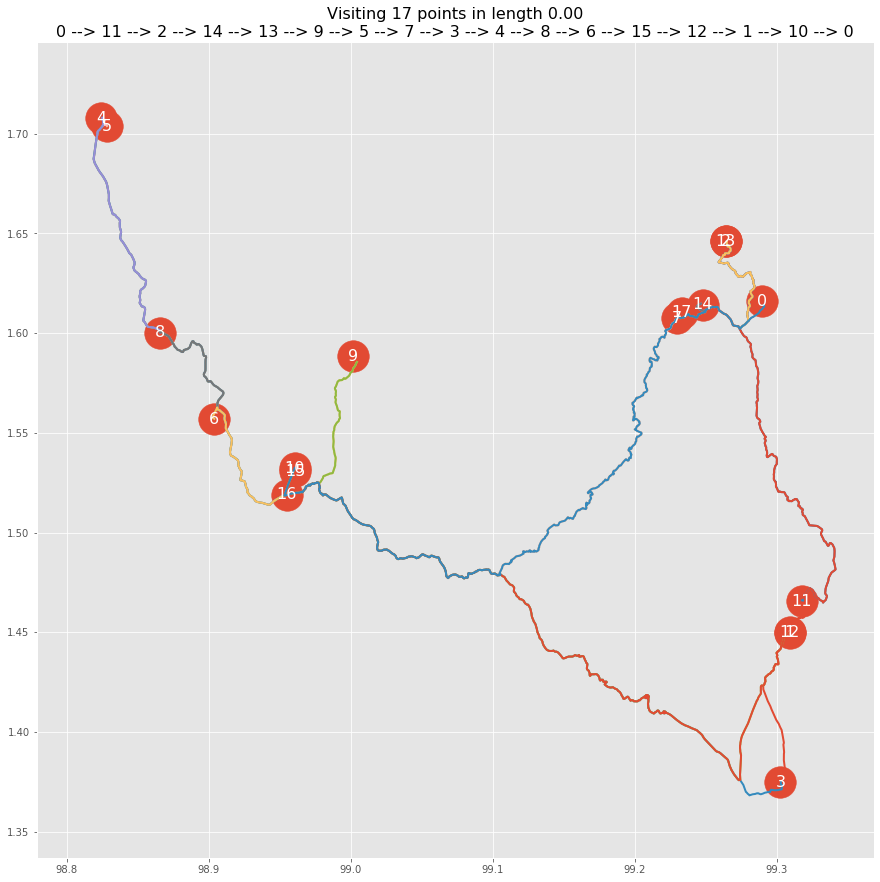

In [75]:
optimization.loc_path_result(dist,route,0,geometry)

In [76]:
geometry

,city1,city2,path
0,0,0,"[[99.290923, 1.614176], [99.290923, 1.614176]]"
1,0,1,"[[99.290923, 1.614176], [99.291312, 1.613426],..."
2,0,2,"[[99.290923, 1.614176], [99.291312, 1.613426],..."
3,0,3,"[[99.290923, 1.614176], [99.291312, 1.613426],..."
4,0,4,"[[99.290923, 1.614176], [99.291312, 1.613426],..."
...,...,...,...
166,15,16,"[[98.960009, 1.531296], [98.958766, 1.52918], ..."
167,15,17,"[[98.960009, 1.531296], [98.958766, 1.52918], ..."
168,16,16,"[[98.955079, 1.518842], [98.955079, 1.518842]]"
169,16,17,"[[98.955079, 1.518842], [98.955545, 1.518974],..."


In [77]:
dist = pd.DataFrame(dist,columns=['latitude',"longitude"])

In [78]:
m = maps.map_marker_plot(dist,
                     ['latitude',"longitude",'latitude',"longitude"], 1.614, 99.290,basemap=None,
                     popup=True,geometry=geometry,zoom=13,route=route)
m.layout.height="1000px"
m

Map(center=[1.614, 99.29], controls=(ZoomControl(options=['position', 'zoom_in_text', 'zoom_in_title', 'zoom_o…

# get image graph

Change zoom level to 12


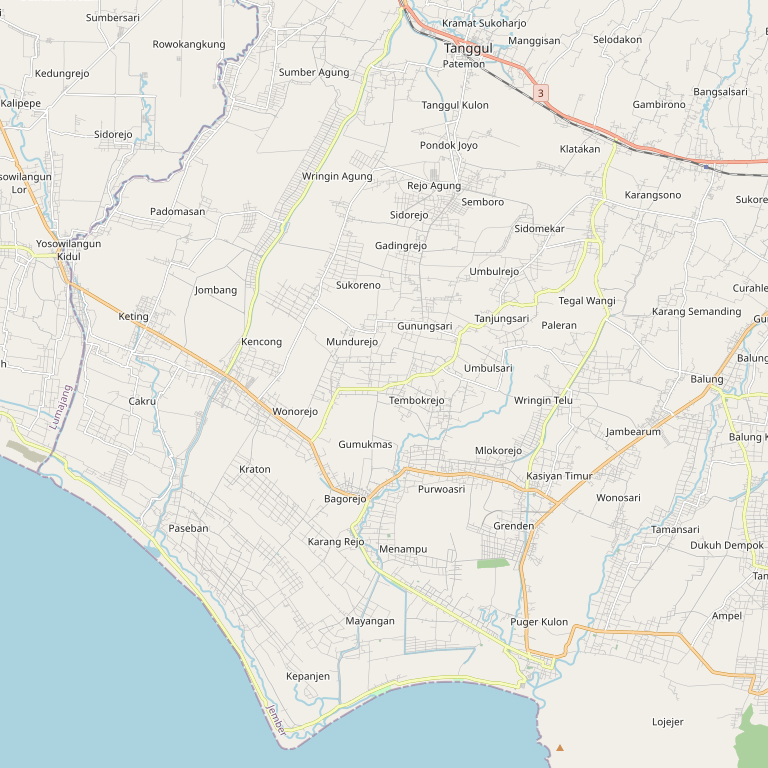

In [79]:
maps.get_image_osm(coor=(-8.36,113.35,-8.2,113.525), zoom=18, server='',margin=.05,tilesize=256,maxtiles=16,show_image=False)

# Geocoding 

In [91]:
data = pd.read_csv(r'E:\gitlab\machine-learning\dataset\map dataset\zomato.csv',encoding="ISO-8859-1")
df = data[['Locality']]

In [102]:
df.iloc[5:10]

,Locality
5,"SM Megamall, Ortigas, Mandaluyong City"
6,"SM by the Bay, Mall of Asia Complex, Pasay City"
7,"SM by the Bay, Mall of Asia Complex, Pasay City"
8,"Sofitel Philippine Plaza Manila, Pasay City"
9,Kapitolyo


In [107]:
res = maps.geocoding(df.iloc[13:15],'Locality',source='osm')

In [108]:
res

13    (14.5942519, 121.0407231)
14    (10.7857333, 122.3001517)
Name: Locality, dtype: object

# testing area